In [31]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications import vgg19
import matplotlib.pyplot as plt
from IPython.display import display
from PIL import Image

%matplotlib inline

In [32]:
def get_images(file_name, path, n_rows, n_cols):
    image_path = keras.utils.get_file(file_name, path)
    image =  keras.preprocessing.image.load_img(image_path ,target_size=(n_rows, n_cols))
    image_arr = keras.preprocessing.image.img_to_array(image)
    img = Image.fromarray(image_arr.astype(np.uint8), 'RGB')
    display(img)
    return image_arr

### Content Image

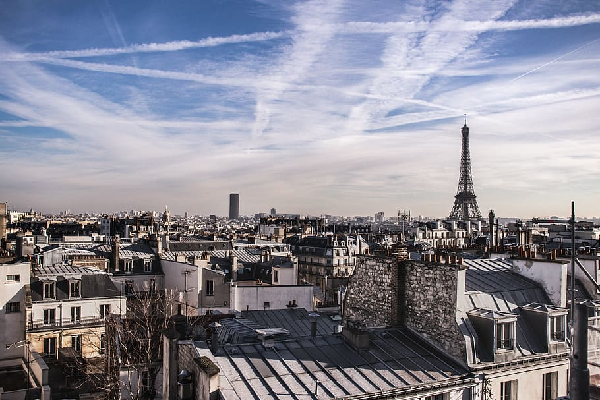

In [33]:
content_image =  get_images("paris.jpg", "https://i.imgur.com/F28w3Ac.jpg", 400 ,600)

### Style image

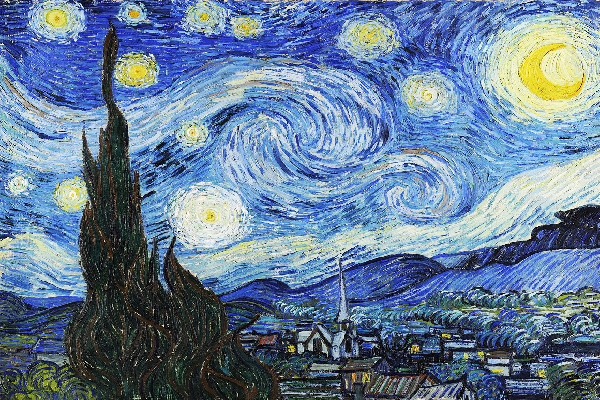

In [34]:
style_image = get_images("starry_night.jpg", "https://i.imgur.com/9ooB60I.jpg", 400, 600)

## Image Preprocessing & deprocessing

In [35]:
def preprocess_image(image):
    #display(Image.fromarray(image.astype(np.uint8), 'RGB'))
    img = np.copy(image)
    img  = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    display(Image.fromarray(img[0].astype(np.uint8), 'RGB'))
    return tf.convert_to_tensor(img)
    
def deprocess_image(a, n_rows, n_cols):
    a = tf.reshape(a,(n_rows,n_cols,3)).numpy()
    # removing  zero-center
    a[:, :, 0] += 103.939
    a[:, :, 1] += 116.779
    a[:, :, 2] += 123.68
    # BGR -> RGB
    a = a[:, :, ::-1]
    a = np.clip(a ,0 ,255).astype(np.uint8)
    return a

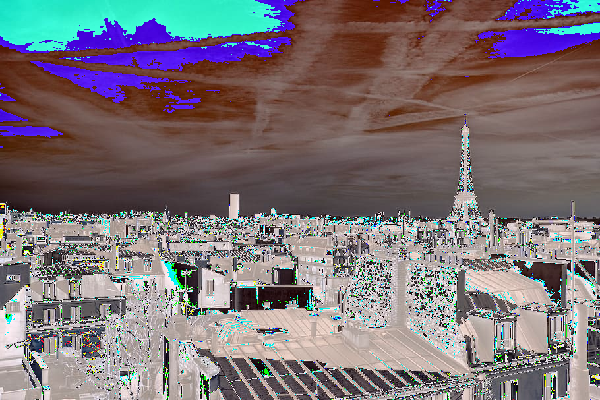

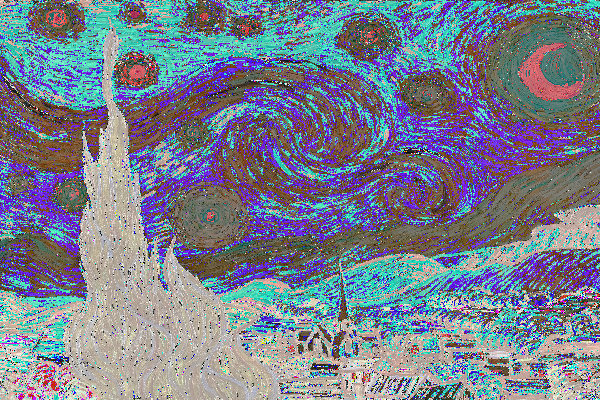

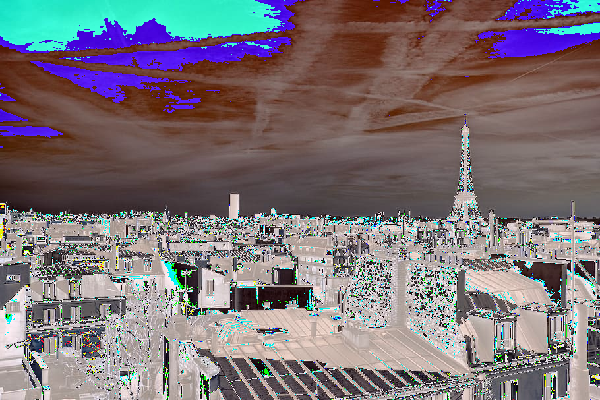

In [36]:
content_image_pr = preprocess_image(content_image)
style_image_pr = preprocess_image(style_image)
combined_image = np.random.randn(400,600,3).astype(np.float32)
combined_image_pr = tf.Variable(preprocess_image(content_image))
#plt.imshow(deprocess_image(style_image_pr, 400, 600))

## Loss Function & utility

In [37]:
def gram_matrix(A):
    A = tf.transpose(A, perm=[2,0,1])
    A = tf.reshape(A, shape=(A.shape[0] ,-1))
    gram_matrix = tf.matmul(A, tf.transpose(A))
    return gram_matrix

def content_loss(content_img, generated_img):
    n_H ,n_W,n_C = content_image.shape
    loss = tf.reduce_sum(tf.square(content_img - generated_img)) / (4.0 * n_H * n_C * n_W)
    return loss

def style_layer_loss(style_img, generated_img):
    GS = gram_matrix(style_img)
    GG = gram_matrix(generated_img)
    n_H ,n_W,n_C = style_img.shape
    loss = tf.reduce_sum(tf.square(GS-GG)) / (4.0 *(n_H * n_C * n_W)**2)
    return loss


def total_variation_loss(x, img_nrows, img_ncols):
    a = tf.square(
        x[:, : img_nrows - 1, : img_ncols - 1, :] - x[:, 1:, : img_ncols - 1, :]
    )
    b = tf.square(
        x[:, : img_nrows - 1, : img_ncols - 1, :] - x[:, : img_nrows - 1, 1:, :]
    )
    return tf.reduce_sum(tf.pow(a + b, 1.25))

def compute_loss(generated_img, content_img, style_img, alpha, beta, lambbda):
    input_tensor = tf.concat(
        [content_img, style_img, generated_img], axis=0
    )
    features = feature_map(input_tensor)
    loss = 0
    
    layer_features = features[content_layer_name]
    content_image_features = layer_features[0 , : , : ,:]
    generated_image_features = layer_features[2, : , : ,:]

    loss += alpha*content_loss(content_image_features, generated_image_features)
    
    s_loss = 0
    for layer_name in style_layer_names:
        layer_features = features[layer_name]
        style_features  = layer_features[1,:,:,:]
        generated_features = layer_features[2,:,:,:]
        s_loss += lambbda*style_layer_loss(style_features, generated_features)
    
    loss += beta*s_loss
    return loss

In [38]:
@tf.function
def compute_loss_and_grad(generated_img, content_img, style_img, alpha, beta, lambbda):
    with tf.GradientTape() as g:
        loss = compute_loss(generated_img, content_img, style_img, alpha, beta, lambbda)
    grads = g.gradient(loss, generated_img)
    return loss, grads

    
def combine(itr,generated_img, content_img, style_img, alpha, beta, lambbda, optimizer):
    final_image_arr = None
    for i in range(0,itr):
        loss, grads = compute_loss_and_grad(generated_img,
                                           content_img,
                                           style_img,
                                           alpha, beta, lambbda)
        #print(loss, grads)
        optimizer.apply_gradients([(grads, generated_img)])
        print(f"Iteration {i}: loss = {loss} ")
        if i%100 == 0:
            img = deprocess_image(generated_img.numpy(), 400, 600)
            image = Image.fromarray(img.astype(np.uint8), 'RGB')
            display(image)
            print("-----------------------")         
        if i == itr:
            final_image_arr = generated_img.numpy()
            img = deprocess_image(generated_img.numpy(), 400, 600)
            final_image = Image.fromarray(img.astype(np.uint8), 'RGB')
            display(final_image)
    return final_image_arr

In [39]:
model = vgg19.VGG19(include_top=False, weights="imagenet")
model.summary()

outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])
feature_map = keras.Model(inputs=model.inputs, outputs=outputs_dict)

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0     

In [40]:
style_layer_names = [
    "block1_conv1",
    "block2_conv1",
    "block3_conv1",
    "block4_conv1",
    "block5_conv1",
]
# The layer to use for the content loss.
content_layer_name = "block5_conv2"

Iteration 0: loss = 78733959168.0 


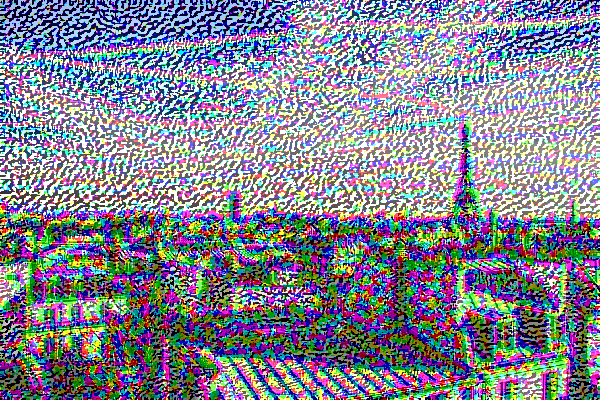

-----------------------
Iteration 1: loss = 6759487897600.0 
Iteration 2: loss = 2076826664960.0 
Iteration 3: loss = 2732145246208.0 
Iteration 4: loss = 2785780957184.0 
Iteration 5: loss = 2676053770240.0 
Iteration 6: loss = 2209768275968.0 
Iteration 7: loss = 1904584949760.0 
Iteration 8: loss = 1561186795520.0 
Iteration 9: loss = 1367971594240.0 
Iteration 10: loss = 1190398525440.0 
Iteration 11: loss = 1026682126336.0 
Iteration 12: loss = 882743050240.0 
Iteration 13: loss = 759067443200.0 
Iteration 14: loss = 659569508352.0 
Iteration 15: loss = 575377637376.0 
Iteration 16: loss = 500301791232.0 
Iteration 17: loss = 433549475840.0 
Iteration 18: loss = 375242686464.0 
Iteration 19: loss = 325789646848.0 
Iteration 20: loss = 284353658880.0 
Iteration 21: loss = 248245420032.0 
Iteration 22: loss = 216721080320.0 
Iteration 23: loss = 189377298432.0 
Iteration 24: loss = 165781536768.0 
Iteration 25: loss = 145574658048.0 
Iteration 26: loss = 128059596800.0 
Iteration 27

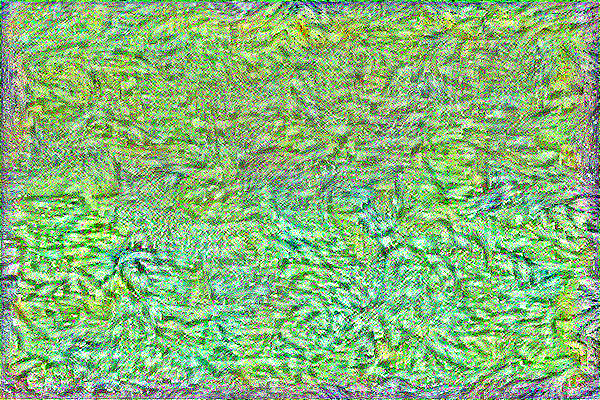

-----------------------
Iteration 101: loss = 2212409088.0 
Iteration 102: loss = 2174118144.0 
Iteration 103: loss = 2137059712.0 
Iteration 104: loss = 2101202688.0 
Iteration 105: loss = 2066475904.0 
Iteration 106: loss = 2032839168.0 
Iteration 107: loss = 2000237824.0 
Iteration 108: loss = 1968644096.0 
Iteration 109: loss = 1937992576.0 
Iteration 110: loss = 1908228736.0 
Iteration 111: loss = 1879336064.0 
Iteration 112: loss = 1851273600.0 
Iteration 113: loss = 1823994880.0 
Iteration 114: loss = 1797477632.0 
Iteration 115: loss = 1771649792.0 
Iteration 116: loss = 1746504832.0 
Iteration 117: loss = 1722018688.0 
Iteration 118: loss = 1698159744.0 
Iteration 119: loss = 1674902400.0 
Iteration 120: loss = 1652234112.0 
Iteration 121: loss = 1630139648.0 
Iteration 122: loss = 1608582016.0 
Iteration 123: loss = 1587539968.0 
Iteration 124: loss = 1567007744.0 
Iteration 125: loss = 1546960768.0 
Iteration 126: loss = 1527370880.0 
Iteration 127: loss = 1508228096.0 
Iter

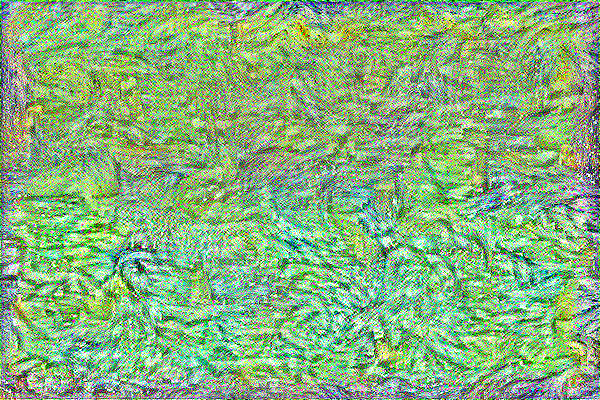

-----------------------
Iteration 201: loss = 748302016.0 
Iteration 202: loss = 742843136.0 
Iteration 203: loss = 737455168.0 
Iteration 204: loss = 732135168.0 
Iteration 205: loss = 726881344.0 
Iteration 206: loss = 721696960.0 
Iteration 207: loss = 716575936.0 
Iteration 208: loss = 711520256.0 
Iteration 209: loss = 706529216.0 
Iteration 210: loss = 701599872.0 
Iteration 211: loss = 696733312.0 
Iteration 212: loss = 691926720.0 
Iteration 213: loss = 687178496.0 
Iteration 214: loss = 682491456.0 
Iteration 215: loss = 677861888.0 
Iteration 216: loss = 673288256.0 
Iteration 217: loss = 668771200.0 
Iteration 218: loss = 664305984.0 
Iteration 219: loss = 659893120.0 
Iteration 220: loss = 655533184.0 
Iteration 221: loss = 651225408.0 
Iteration 222: loss = 646968704.0 
Iteration 223: loss = 642759936.0 
Iteration 224: loss = 638598784.0 
Iteration 225: loss = 634484480.0 
Iteration 226: loss = 630419776.0 
Iteration 227: loss = 626403328.0 
Iteration 228: loss = 622434624

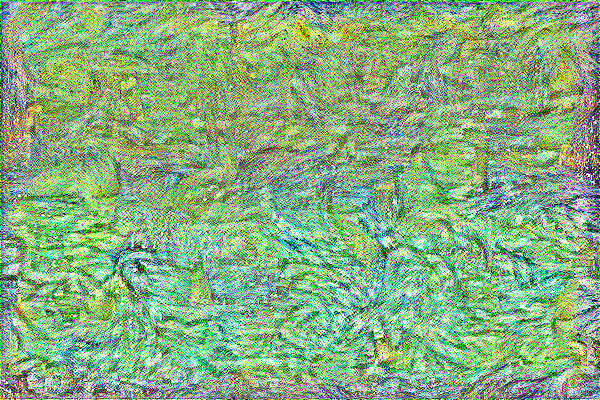

-----------------------
Iteration 301: loss = 420228608.0 
Iteration 302: loss = 418316640.0 
Iteration 303: loss = 416421568.0 
Iteration 304: loss = 414542752.0 
Iteration 305: loss = 412679392.0 
Iteration 306: loss = 410832736.0 
Iteration 307: loss = 409001280.0 
Iteration 308: loss = 407184896.0 
Iteration 309: loss = 405383968.0 
Iteration 310: loss = 403598624.0 
Iteration 311: loss = 401827360.0 
Iteration 312: loss = 400071232.0 
Iteration 313: loss = 398329920.0 
Iteration 314: loss = 396603456.0 
Iteration 315: loss = 394889856.0 
Iteration 316: loss = 393189312.0 
Iteration 317: loss = 391502880.0 
Iteration 318: loss = 389830144.0 
Iteration 319: loss = 388170368.0 
Iteration 320: loss = 386523904.0 
Iteration 321: loss = 384889952.0 
Iteration 322: loss = 383268416.0 
Iteration 323: loss = 381658784.0 
Iteration 324: loss = 380061408.0 
Iteration 325: loss = 378475680.0 
Iteration 326: loss = 376901824.0 
Iteration 327: loss = 375339584.0 
Iteration 328: loss = 373788192

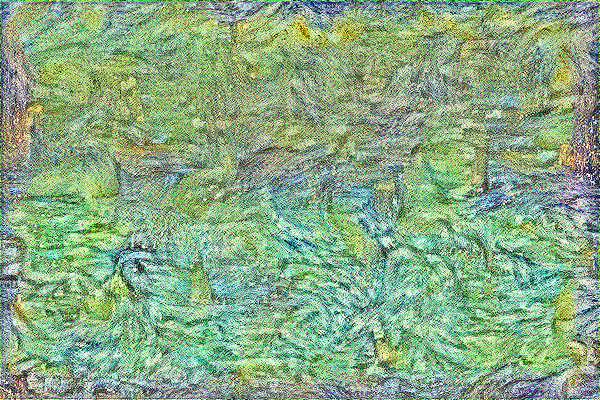

-----------------------
Iteration 401: loss = 285905504.0 
Iteration 402: loss = 284972992.0 
Iteration 403: loss = 284046112.0 
Iteration 404: loss = 283124672.0 
Iteration 405: loss = 282209408.0 
Iteration 406: loss = 281299648.0 
Iteration 407: loss = 280395264.0 
Iteration 408: loss = 279496352.0 
Iteration 409: loss = 278603392.0 
Iteration 410: loss = 277716256.0 
Iteration 411: loss = 276834208.0 
Iteration 412: loss = 275957120.0 
Iteration 413: loss = 275085216.0 
Iteration 414: loss = 274218944.0 
Iteration 415: loss = 273357984.0 
Iteration 416: loss = 272502464.0 
Iteration 417: loss = 271652544.0 
Iteration 418: loss = 270807264.0 
Iteration 419: loss = 269967104.0 
Iteration 420: loss = 269131712.0 
Iteration 421: loss = 268301392.0 
Iteration 422: loss = 267475808.0 
Iteration 423: loss = 266655152.0 
Iteration 424: loss = 265839344.0 
Iteration 425: loss = 265027904.0 
Iteration 426: loss = 264221568.0 
Iteration 427: loss = 263420080.0 
Iteration 428: loss = 262622512

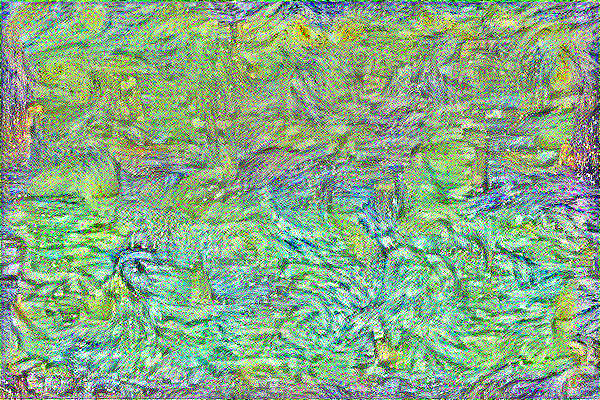

-----------------------
Iteration 501: loss = 214821600.0 
Iteration 502: loss = 214283360.0 
Iteration 503: loss = 213747840.0 
Iteration 504: loss = 213214784.0 
Iteration 505: loss = 212684288.0 
Iteration 506: loss = 212156480.0 
Iteration 507: loss = 211631136.0 
Iteration 508: loss = 211108304.0 
Iteration 509: loss = 210588304.0 
Iteration 510: loss = 210070528.0 
Iteration 511: loss = 209555296.0 
Iteration 512: loss = 209042560.0 
Iteration 513: loss = 208531968.0 
Iteration 514: loss = 208023952.0 
Iteration 515: loss = 207518576.0 
Iteration 516: loss = 207015152.0 
Iteration 517: loss = 206513984.0 
Iteration 518: loss = 206015056.0 
Iteration 519: loss = 205518592.0 
Iteration 520: loss = 205024160.0 
Iteration 521: loss = 204531888.0 
Iteration 522: loss = 204041968.0 
Iteration 523: loss = 203554176.0 
Iteration 524: loss = 203068688.0 
Iteration 525: loss = 202585664.0 
Iteration 526: loss = 202104672.0 
Iteration 527: loss = 201625712.0 
Iteration 528: loss = 201149008

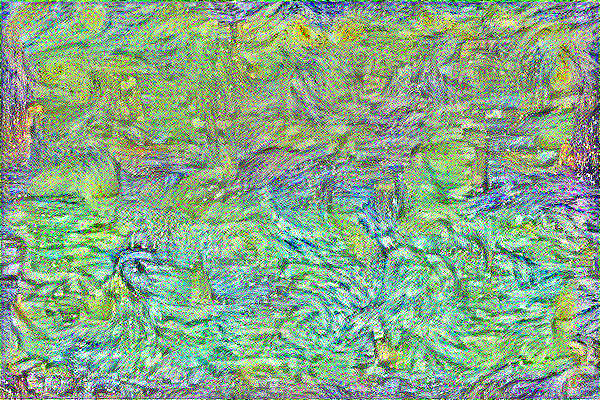

-----------------------
Iteration 601: loss = 171254768.0 
Iteration 602: loss = 170902720.0 
Iteration 603: loss = 170551936.0 
Iteration 604: loss = 170202464.0 
Iteration 605: loss = 169854416.0 
Iteration 606: loss = 169507552.0 
Iteration 607: loss = 169161824.0 
Iteration 608: loss = 168817392.0 
Iteration 609: loss = 168474208.0 
Iteration 610: loss = 168132592.0 
Iteration 611: loss = 167792160.0 
Iteration 612: loss = 167452864.0 
Iteration 613: loss = 167115024.0 
Iteration 614: loss = 166778464.0 
Iteration 615: loss = 166443040.0 
Iteration 616: loss = 166108784.0 
Iteration 617: loss = 165775952.0 
Iteration 618: loss = 165444288.0 
Iteration 619: loss = 165113808.0 
Iteration 620: loss = 164784544.0 
Iteration 621: loss = 164456704.0 
Iteration 622: loss = 164130016.0 
Iteration 623: loss = 163804480.0 
Iteration 624: loss = 163480080.0 
Iteration 625: loss = 163157008.0 
Iteration 626: loss = 162835136.0 
Iteration 627: loss = 162514416.0 
Iteration 628: loss = 162194896

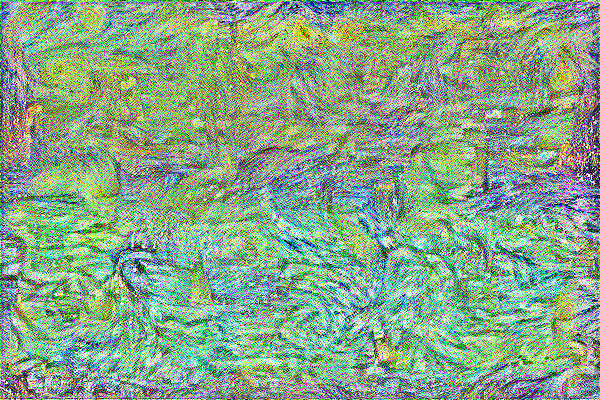

-----------------------
Iteration 701: loss = 141660400.0 
Iteration 702: loss = 141412352.0 
Iteration 703: loss = 141165184.0 
Iteration 704: loss = 140918816.0 
Iteration 705: loss = 140673184.0 
Iteration 706: loss = 140428336.0 
Iteration 707: loss = 140184320.0 
Iteration 708: loss = 139941120.0 
Iteration 709: loss = 139698688.0 
Iteration 710: loss = 139456928.0 
Iteration 711: loss = 139215952.0 
Iteration 712: loss = 138975632.0 
Iteration 713: loss = 138736080.0 
Iteration 714: loss = 138497152.0 
Iteration 715: loss = 138259088.0 
Iteration 716: loss = 138021792.0 
Iteration 717: loss = 137785232.0 
Iteration 718: loss = 137549440.0 
Iteration 719: loss = 137314432.0 
Iteration 720: loss = 137080112.0 
Iteration 721: loss = 136846544.0 
Iteration 722: loss = 136613792.0 
Iteration 723: loss = 136381664.0 
Iteration 724: loss = 136150320.0 
Iteration 725: loss = 135919664.0 
Iteration 726: loss = 135689760.0 
Iteration 727: loss = 135460640.0 
Iteration 728: loss = 135232272

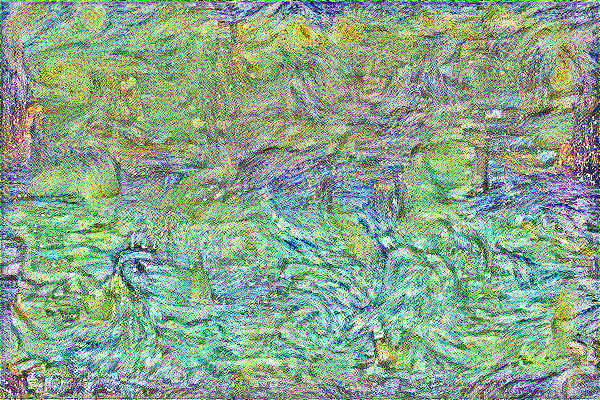

-----------------------
Iteration 801: loss = 120269568.0 
Iteration 802: loss = 120085632.0 
Iteration 803: loss = 119902280.0 
Iteration 804: loss = 119719416.0 
Iteration 805: loss = 119537024.0 
Iteration 806: loss = 119355120.0 
Iteration 807: loss = 119173784.0 
Iteration 808: loss = 118992920.0 
Iteration 809: loss = 118812496.0 
Iteration 810: loss = 118632600.0 
Iteration 811: loss = 118453184.0 
Iteration 812: loss = 118274216.0 
Iteration 813: loss = 118095824.0 
Iteration 814: loss = 117917936.0 
Iteration 815: loss = 117740488.0 
Iteration 816: loss = 117563496.0 
Iteration 817: loss = 117387072.0 
Iteration 818: loss = 117211048.0 
Iteration 819: loss = 117035584.0 
Iteration 820: loss = 116860520.0 
Iteration 821: loss = 116685976.0 
Iteration 822: loss = 116511960.0 
Iteration 823: loss = 116338424.0 
Iteration 824: loss = 116165400.0 
Iteration 825: loss = 115992760.0 
Iteration 826: loss = 115820712.0 
Iteration 827: loss = 115649104.0 
Iteration 828: loss = 115477992

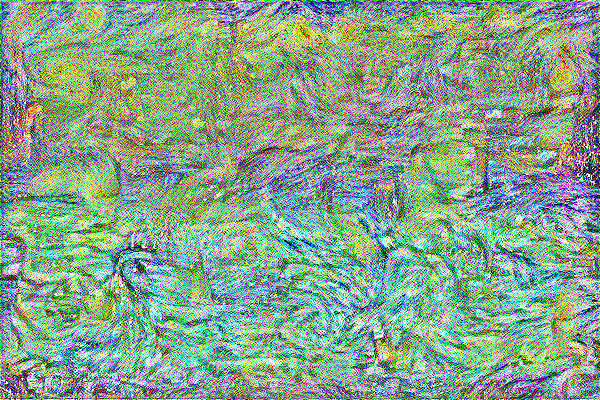

-----------------------
Iteration 901: loss = 104119064.0 
Iteration 902: loss = 103977432.0 
Iteration 903: loss = 103836136.0 
Iteration 904: loss = 103695224.0 
Iteration 905: loss = 103554632.0 
Iteration 906: loss = 103414408.0 
Iteration 907: loss = 103274576.0 
Iteration 908: loss = 103134992.0 
Iteration 909: loss = 102995776.0 
Iteration 910: loss = 102856856.0 
Iteration 911: loss = 102718328.0 
Iteration 912: loss = 102580152.0 
Iteration 913: loss = 102442320.0 
Iteration 914: loss = 102304824.0 
Iteration 915: loss = 102167736.0 
Iteration 916: loss = 102030936.0 
Iteration 917: loss = 101894552.0 
Iteration 918: loss = 101758480.0 
Iteration 919: loss = 101622824.0 
Iteration 920: loss = 101487408.0 
Iteration 921: loss = 101352384.0 
Iteration 922: loss = 101217688.0 
Iteration 923: loss = 101083360.0 
Iteration 924: loss = 100949408.0 
Iteration 925: loss = 100815768.0 
Iteration 926: loss = 100682440.0 
Iteration 927: loss = 100549408.0 
Iteration 928: loss = 100416760

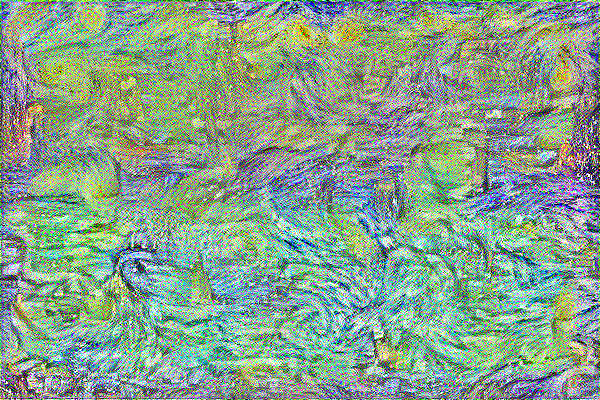

-----------------------
Iteration 1001: loss = 91547120.0 
Iteration 1002: loss = 91435912.0 
Iteration 1003: loss = 91324896.0 
Iteration 1004: loss = 91214176.0 
Iteration 1005: loss = 91103616.0 
Iteration 1006: loss = 90993376.0 
Iteration 1007: loss = 90883384.0 
Iteration 1008: loss = 90773520.0 
Iteration 1009: loss = 90664000.0 
Iteration 1010: loss = 90554696.0 
Iteration 1011: loss = 90445608.0 
Iteration 1012: loss = 90336760.0 
Iteration 1013: loss = 90228176.0 
Iteration 1014: loss = 90119800.0 
Iteration 1015: loss = 90011720.0 
Iteration 1016: loss = 89903856.0 
Iteration 1017: loss = 89796312.0 
Iteration 1018: loss = 89688960.0 
Iteration 1019: loss = 89581912.0 
Iteration 1020: loss = 89475056.0 
Iteration 1021: loss = 89368464.0 
Iteration 1022: loss = 89262088.0 
Iteration 1023: loss = 89155968.0 
Iteration 1024: loss = 89050088.0 
Iteration 1025: loss = 88944440.0 
Iteration 1026: loss = 88839008.0 
Iteration 1027: loss = 88733784.0 
Iteration 1028: loss = 88628824

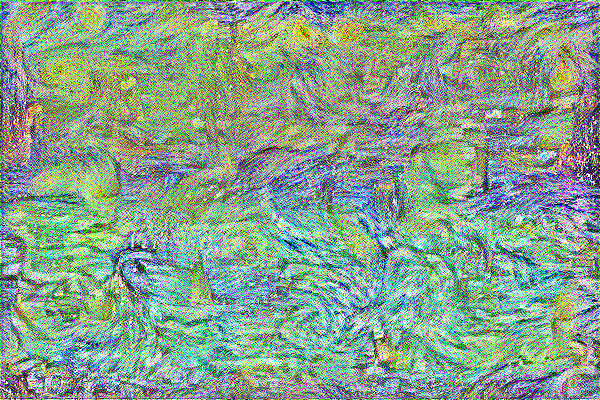

-----------------------
Iteration 1101: loss = 81563712.0 
Iteration 1102: loss = 81474552.0 
Iteration 1103: loss = 81385600.0 
Iteration 1104: loss = 81296856.0 
Iteration 1105: loss = 81208256.0 
Iteration 1106: loss = 81119848.0 
Iteration 1107: loss = 81031672.0 
Iteration 1108: loss = 80943624.0 
Iteration 1109: loss = 80855872.0 
Iteration 1110: loss = 80768256.0 
Iteration 1111: loss = 80680784.0 
Iteration 1112: loss = 80593512.0 
Iteration 1113: loss = 80506424.0 
Iteration 1114: loss = 80419568.0 
Iteration 1115: loss = 80332840.0 
Iteration 1116: loss = 80246320.0 
Iteration 1117: loss = 80159944.0 
Iteration 1118: loss = 80073760.0 
Iteration 1119: loss = 79987808.0 
Iteration 1120: loss = 79902016.0 
Iteration 1121: loss = 79816400.0 
Iteration 1122: loss = 79730976.0 
Iteration 1123: loss = 79645744.0 
Iteration 1124: loss = 79560704.0 
Iteration 1125: loss = 79475880.0 
Iteration 1126: loss = 79391200.0 
Iteration 1127: loss = 79306736.0 
Iteration 1128: loss = 79222472

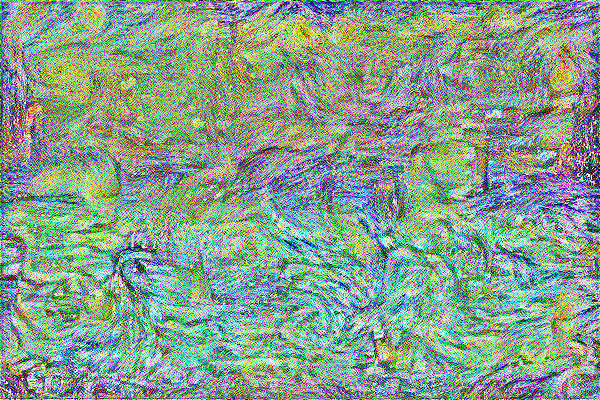

-----------------------
Iteration 1201: loss = 73518960.0 
Iteration 1202: loss = 73446760.0 
Iteration 1203: loss = 73374608.0 
Iteration 1204: loss = 73302696.0 
Iteration 1205: loss = 73230912.0 
Iteration 1206: loss = 73159304.0 
Iteration 1207: loss = 73087792.0 
Iteration 1208: loss = 73016496.0 
Iteration 1209: loss = 72945312.0 
Iteration 1210: loss = 72874256.0 
Iteration 1211: loss = 72803328.0 
Iteration 1212: loss = 72732544.0 
Iteration 1213: loss = 72661920.0 
Iteration 1214: loss = 72591480.0 
Iteration 1215: loss = 72521112.0 
Iteration 1216: loss = 72450920.0 
Iteration 1217: loss = 72380864.0 
Iteration 1218: loss = 72310920.0 
Iteration 1219: loss = 72241136.0 
Iteration 1220: loss = 72171440.0 
Iteration 1221: loss = 72101920.0 
Iteration 1222: loss = 72032520.0 
Iteration 1223: loss = 71963280.0 
Iteration 1224: loss = 71894208.0 
Iteration 1225: loss = 71825232.0 
Iteration 1226: loss = 71756384.0 
Iteration 1227: loss = 71687696.0 
Iteration 1228: loss = 71619176

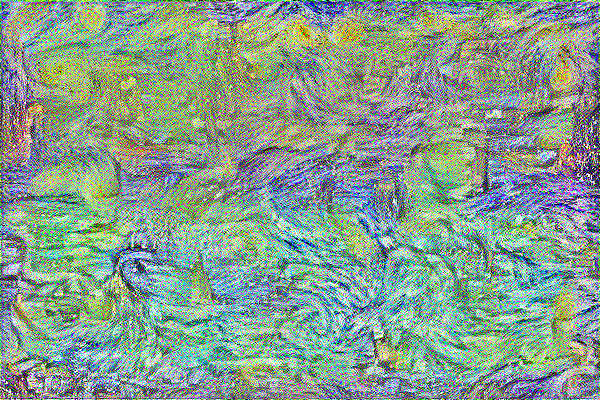

-----------------------
Iteration 1301: loss = 66961052.0 
Iteration 1302: loss = 66901672.0 
Iteration 1303: loss = 66842420.0 
Iteration 1304: loss = 66783324.0 
Iteration 1305: loss = 66724312.0 
Iteration 1306: loss = 66665412.0 
Iteration 1307: loss = 66606640.0 
Iteration 1308: loss = 66547936.0 
Iteration 1309: loss = 66489408.0 
Iteration 1310: loss = 66430912.0 
Iteration 1311: loss = 66372552.0 
Iteration 1312: loss = 66314296.0 
Iteration 1313: loss = 66256124.0 
Iteration 1314: loss = 66198060.0 
Iteration 1315: loss = 66140132.0 
Iteration 1316: loss = 66082320.0 
Iteration 1317: loss = 66024604.0 
Iteration 1318: loss = 65967000.0 
Iteration 1319: loss = 65909512.0 
Iteration 1320: loss = 65852144.0 
Iteration 1321: loss = 65794896.0 
Iteration 1322: loss = 65737732.0 
Iteration 1323: loss = 65680704.0 
Iteration 1324: loss = 65623768.0 
Iteration 1325: loss = 65566908.0 
Iteration 1326: loss = 65510160.0 
Iteration 1327: loss = 65453508.0 
Iteration 1328: loss = 65397036

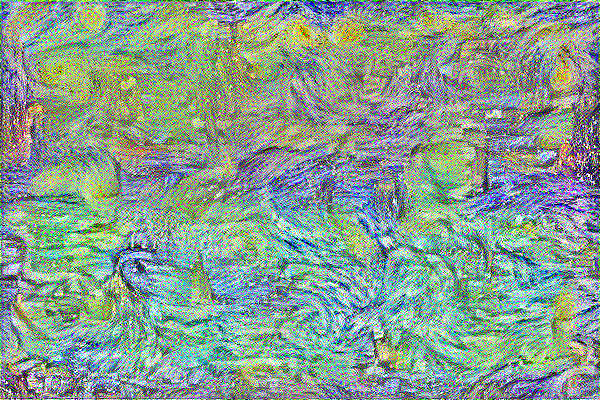

-----------------------
Iteration 1401: loss = 61535372.0 
Iteration 1402: loss = 61485920.0 
Iteration 1403: loss = 61436616.0 
Iteration 1404: loss = 61387384.0 
Iteration 1405: loss = 61338232.0 
Iteration 1406: loss = 61289152.0 
Iteration 1407: loss = 61240232.0 
Iteration 1408: loss = 61191380.0 
Iteration 1409: loss = 61142640.0 
Iteration 1410: loss = 61093984.0 
Iteration 1411: loss = 61045404.0 
Iteration 1412: loss = 60996936.0 
Iteration 1413: loss = 60948544.0 
Iteration 1414: loss = 60900268.0 
Iteration 1415: loss = 60852032.0 
Iteration 1416: loss = 60803944.0 
Iteration 1417: loss = 60755944.0 
Iteration 1418: loss = 60708004.0 
Iteration 1419: loss = 60660164.0 
Iteration 1420: loss = 60612468.0 
Iteration 1421: loss = 60564780.0 
Iteration 1422: loss = 60517196.0 
Iteration 1423: loss = 60469720.0 
Iteration 1424: loss = 60422296.0 
Iteration 1425: loss = 60374960.0 
Iteration 1426: loss = 60327728.0 
Iteration 1427: loss = 60280568.0 
Iteration 1428: loss = 60233472

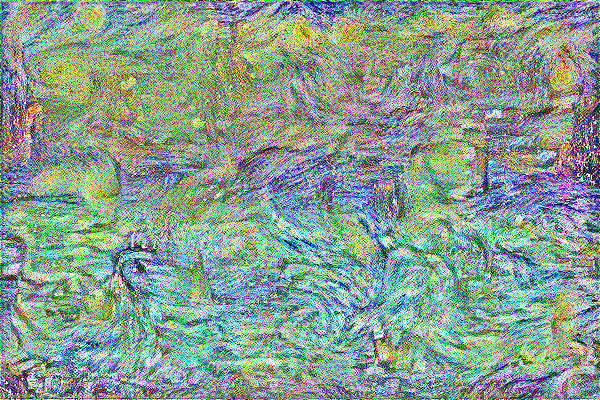

-----------------------
Iteration 1501: loss = 57009696.0 
Iteration 1502: loss = 56968324.0 
Iteration 1503: loss = 56927060.0 
Iteration 1504: loss = 56885852.0 
Iteration 1505: loss = 56844700.0 
Iteration 1506: loss = 56803632.0 
Iteration 1507: loss = 56762632.0 
Iteration 1508: loss = 56721720.0 
Iteration 1509: loss = 56680872.0 
Iteration 1510: loss = 56640088.0 
Iteration 1511: loss = 56599380.0 
Iteration 1512: loss = 56558744.0 
Iteration 1513: loss = 56518172.0 
Iteration 1514: loss = 56477644.0 
Iteration 1515: loss = 56437172.0 
Iteration 1516: loss = 56396832.0 
Iteration 1517: loss = 56356528.0 
Iteration 1518: loss = 56316320.0 
Iteration 1519: loss = 56276140.0 
Iteration 1520: loss = 56236020.0 
Iteration 1521: loss = 56196036.0 
Iteration 1522: loss = 56156080.0 
Iteration 1523: loss = 56116180.0 
Iteration 1524: loss = 56076364.0 
Iteration 1525: loss = 56036608.0 
Iteration 1526: loss = 55996892.0 
Iteration 1527: loss = 55957288.0 
Iteration 1528: loss = 55917740

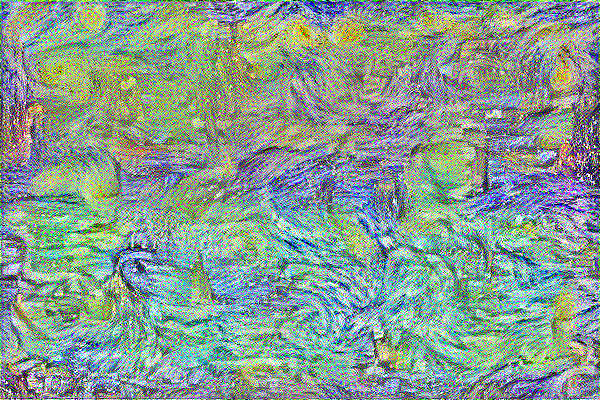

-----------------------
Iteration 1601: loss = 53202548.0 
Iteration 1602: loss = 53167472.0 
Iteration 1603: loss = 53132516.0 
Iteration 1604: loss = 53097584.0 
Iteration 1605: loss = 53062692.0 
Iteration 1606: loss = 53027852.0 
Iteration 1607: loss = 52993080.0 
Iteration 1608: loss = 52958360.0 
Iteration 1609: loss = 52923716.0 
Iteration 1610: loss = 52889104.0 
Iteration 1611: loss = 52854576.0 
Iteration 1612: loss = 52820068.0 
Iteration 1613: loss = 52785656.0 
Iteration 1614: loss = 52751296.0 
Iteration 1615: loss = 52716968.0 
Iteration 1616: loss = 52682700.0 
Iteration 1617: loss = 52648508.0 
Iteration 1618: loss = 52614352.0 
Iteration 1619: loss = 52580280.0 
Iteration 1620: loss = 52546244.0 
Iteration 1621: loss = 52512272.0 
Iteration 1622: loss = 52478348.0 
Iteration 1623: loss = 52444440.0 
Iteration 1624: loss = 52410624.0 
Iteration 1625: loss = 52376832.0 
Iteration 1626: loss = 52343120.0 
Iteration 1627: loss = 52309436.0 
Iteration 1628: loss = 52275808

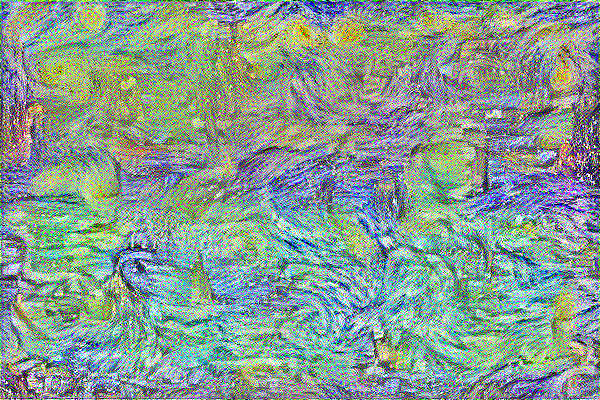

-----------------------
Iteration 1701: loss = 49959180.0 
Iteration 1702: loss = 49929228.0 
Iteration 1703: loss = 49899332.0 
Iteration 1704: loss = 49869496.0 
Iteration 1705: loss = 49839672.0 
Iteration 1706: loss = 49809920.0 
Iteration 1707: loss = 49780176.0 
Iteration 1708: loss = 49750488.0 
Iteration 1709: loss = 49720856.0 
Iteration 1710: loss = 49691280.0 
Iteration 1711: loss = 49661736.0 
Iteration 1712: loss = 49632232.0 
Iteration 1713: loss = 49602776.0 
Iteration 1714: loss = 49573380.0 
Iteration 1715: loss = 49544012.0 
Iteration 1716: loss = 49514684.0 
Iteration 1717: loss = 49485412.0 
Iteration 1718: loss = 49456196.0 
Iteration 1719: loss = 49427004.0 
Iteration 1720: loss = 49397892.0 
Iteration 1721: loss = 49368784.0 
Iteration 1722: loss = 49339700.0 
Iteration 1723: loss = 49310700.0 
Iteration 1724: loss = 49281716.0 
Iteration 1725: loss = 49252804.0 
Iteration 1726: loss = 49223908.0 
Iteration 1727: loss = 49195032.0 
Iteration 1728: loss = 49166228

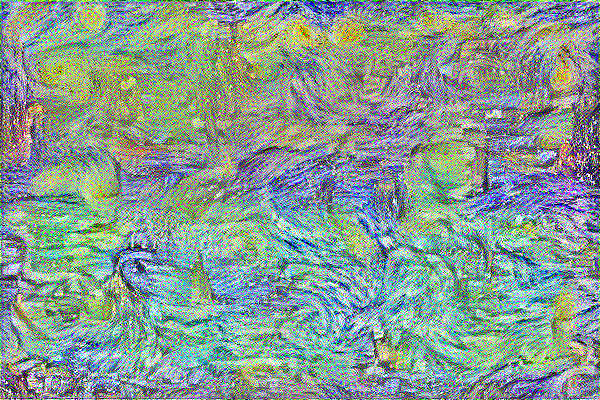

-----------------------
Iteration 1801: loss = 47175444.0 
Iteration 1802: loss = 47149664.0 
Iteration 1803: loss = 47123908.0 
Iteration 1804: loss = 47098204.0 
Iteration 1805: loss = 47072536.0 
Iteration 1806: loss = 47046904.0 
Iteration 1807: loss = 47021324.0 
Iteration 1808: loss = 46995764.0 
Iteration 1809: loss = 46970236.0 
Iteration 1810: loss = 46944760.0 
Iteration 1811: loss = 46919328.0 
Iteration 1812: loss = 46893944.0 
Iteration 1813: loss = 46868568.0 
Iteration 1814: loss = 46843248.0 
Iteration 1815: loss = 46817964.0 
Iteration 1816: loss = 46792732.0 
Iteration 1817: loss = 46767532.0 
Iteration 1818: loss = 46742380.0 
Iteration 1819: loss = 46717236.0 
Iteration 1820: loss = 46692160.0 
Iteration 1821: loss = 46667092.0 
Iteration 1822: loss = 46642112.0 
Iteration 1823: loss = 46617148.0 
Iteration 1824: loss = 46592208.0 
Iteration 1825: loss = 46567308.0 
Iteration 1826: loss = 46542424.0 
Iteration 1827: loss = 46517636.0 
Iteration 1828: loss = 46492804

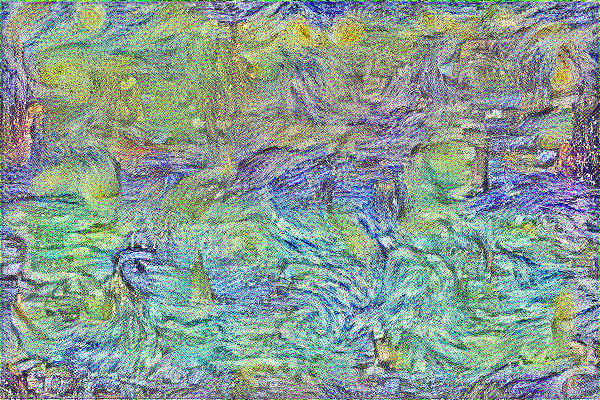

-----------------------
Iteration 1901: loss = 44773540.0 
Iteration 1902: loss = 44751184.0 
Iteration 1903: loss = 44728848.0 
Iteration 1904: loss = 44706560.0 
Iteration 1905: loss = 44684296.0 
Iteration 1906: loss = 44662064.0 
Iteration 1907: loss = 44639856.0 
Iteration 1908: loss = 44617684.0 
Iteration 1909: loss = 44595532.0 
Iteration 1910: loss = 44573420.0 
Iteration 1911: loss = 44551312.0 
Iteration 1912: loss = 44529268.0 
Iteration 1913: loss = 44507256.0 
Iteration 1914: loss = 44485248.0 
Iteration 1915: loss = 44463300.0 
Iteration 1916: loss = 44441372.0 
Iteration 1917: loss = 44419476.0 
Iteration 1918: loss = 44397624.0 
Iteration 1919: loss = 44375760.0 
Iteration 1920: loss = 44353968.0 
Iteration 1921: loss = 44332188.0 
Iteration 1922: loss = 44310448.0 
Iteration 1923: loss = 44288732.0 
Iteration 1924: loss = 44267052.0 
Iteration 1925: loss = 44245404.0 
Iteration 1926: loss = 44223756.0 
Iteration 1927: loss = 44202176.0 
Iteration 1928: loss = 44180584

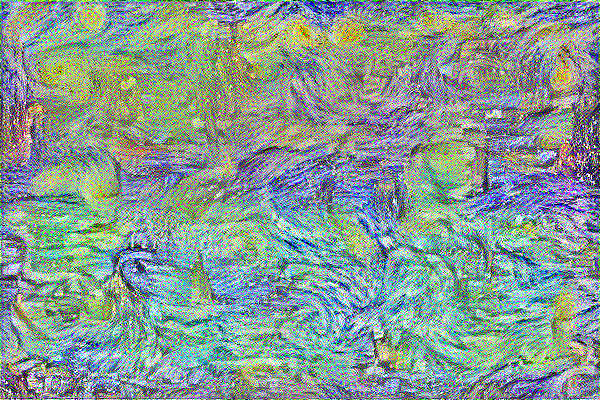

-----------------------
Iteration 2001: loss = 42680396.0 
Iteration 2002: loss = 42660812.0 
Iteration 2003: loss = 42641244.0 
Iteration 2004: loss = 42621720.0 
Iteration 2005: loss = 42602212.0 
Iteration 2006: loss = 42582720.0 
Iteration 2007: loss = 42563280.0 
Iteration 2008: loss = 42543860.0 
Iteration 2009: loss = 42524444.0 
Iteration 2010: loss = 42505092.0 
Iteration 2011: loss = 42485724.0 
Iteration 2012: loss = 42466400.0 
Iteration 2013: loss = 42447124.0 
Iteration 2014: loss = 42427856.0 
Iteration 2015: loss = 42408592.0 
Iteration 2016: loss = 42389372.0 
Iteration 2017: loss = 42370172.0 
Iteration 2018: loss = 42351016.0 
Iteration 2019: loss = 42331860.0 
Iteration 2020: loss = 42312752.0 
Iteration 2021: loss = 42293652.0 
Iteration 2022: loss = 42274568.0 
Iteration 2023: loss = 42255540.0 
Iteration 2024: loss = 42236512.0 
Iteration 2025: loss = 42217496.0 
Iteration 2026: loss = 42198536.0 
Iteration 2027: loss = 42179592.0 
Iteration 2028: loss = 42160668

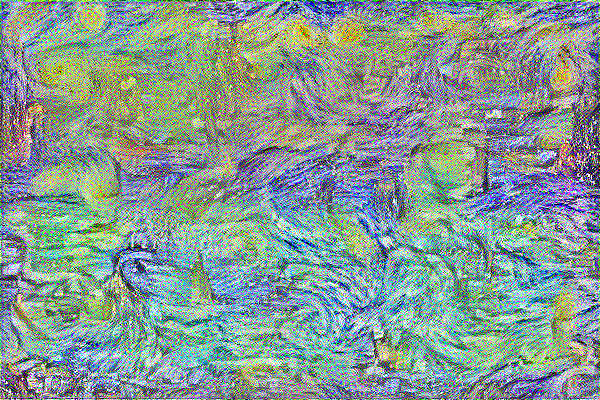

-----------------------
Iteration 2101: loss = 40841228.0 
Iteration 2102: loss = 40824004.0 
Iteration 2103: loss = 40806780.0 
Iteration 2104: loss = 40789532.0 
Iteration 2105: loss = 40772376.0 
Iteration 2106: loss = 40755200.0 
Iteration 2107: loss = 40738048.0 
Iteration 2108: loss = 40720912.0 
Iteration 2109: loss = 40703804.0 
Iteration 2110: loss = 40686760.0 
Iteration 2111: loss = 40669680.0 
Iteration 2112: loss = 40652648.0 
Iteration 2113: loss = 40635620.0 
Iteration 2114: loss = 40618604.0 
Iteration 2115: loss = 40601636.0 
Iteration 2116: loss = 40584680.0 
Iteration 2117: loss = 40567748.0 
Iteration 2118: loss = 40550828.0 
Iteration 2119: loss = 40533940.0 
Iteration 2120: loss = 40517048.0 
Iteration 2121: loss = 40500204.0 
Iteration 2122: loss = 40483372.0 
Iteration 2123: loss = 40466540.0 
Iteration 2124: loss = 40449740.0 
Iteration 2125: loss = 40432980.0 
Iteration 2126: loss = 40416256.0 
Iteration 2127: loss = 40399508.0 
Iteration 2128: loss = 40382788

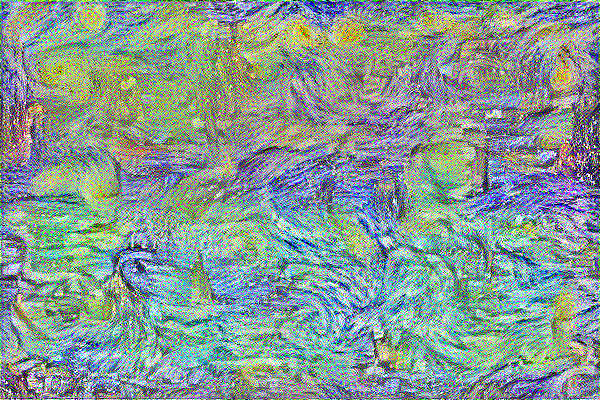

-----------------------
Iteration 2201: loss = 39215800.0 
Iteration 2202: loss = 39200504.0 
Iteration 2203: loss = 39185224.0 
Iteration 2204: loss = 39169960.0 
Iteration 2205: loss = 39154724.0 
Iteration 2206: loss = 39139520.0 
Iteration 2207: loss = 39124300.0 
Iteration 2208: loss = 39109112.0 
Iteration 2209: loss = 39093940.0 
Iteration 2210: loss = 39078780.0 
Iteration 2211: loss = 39063648.0 
Iteration 2212: loss = 39048516.0 
Iteration 2213: loss = 39033424.0 
Iteration 2214: loss = 39018352.0 
Iteration 2215: loss = 39003284.0 
Iteration 2216: loss = 38988232.0 
Iteration 2217: loss = 38973192.0 
Iteration 2218: loss = 38958160.0 
Iteration 2219: loss = 38943160.0 
Iteration 2220: loss = 38928156.0 
Iteration 2221: loss = 38913208.0 
Iteration 2222: loss = 38898268.0 
Iteration 2223: loss = 38883320.0 
Iteration 2224: loss = 38868400.0 
Iteration 2225: loss = 38853500.0 
Iteration 2226: loss = 38838620.0 
Iteration 2227: loss = 38823772.0 
Iteration 2228: loss = 38808924

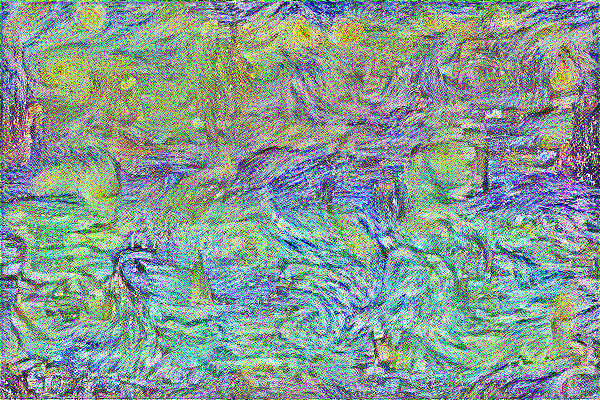

-----------------------
Iteration 2301: loss = 37768976.0 
Iteration 2302: loss = 37755316.0 
Iteration 2303: loss = 37741684.0 
Iteration 2304: loss = 37728056.0 
Iteration 2305: loss = 37714436.0 
Iteration 2306: loss = 37700844.0 
Iteration 2307: loss = 37687248.0 
Iteration 2308: loss = 37673680.0 
Iteration 2309: loss = 37660116.0 
Iteration 2310: loss = 37646576.0 
Iteration 2311: loss = 37633048.0 
Iteration 2312: loss = 37619540.0 
Iteration 2313: loss = 37606032.0 
Iteration 2314: loss = 37592552.0 
Iteration 2315: loss = 37579056.0 
Iteration 2316: loss = 37565584.0 
Iteration 2317: loss = 37552140.0 
Iteration 2318: loss = 37538704.0 
Iteration 2319: loss = 37525304.0 
Iteration 2320: loss = 37511888.0 
Iteration 2321: loss = 37498480.0 
Iteration 2322: loss = 37485140.0 
Iteration 2323: loss = 37471756.0 
Iteration 2324: loss = 37458416.0 
Iteration 2325: loss = 37445076.0 
Iteration 2326: loss = 37431764.0 
Iteration 2327: loss = 37418468.0 
Iteration 2328: loss = 37405176

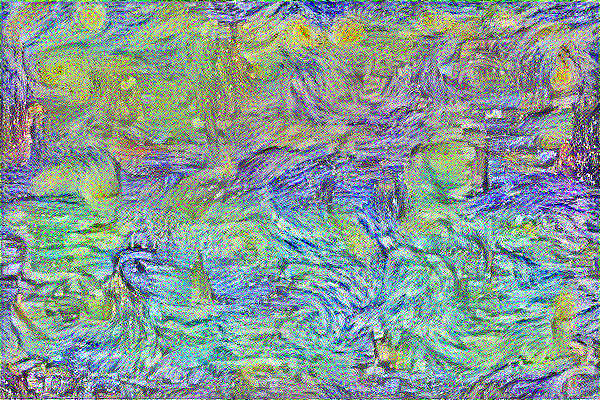

-----------------------
Iteration 2401: loss = 36472832.0 
Iteration 2402: loss = 36460552.0 
Iteration 2403: loss = 36448252.0 
Iteration 2404: loss = 36436004.0 
Iteration 2405: loss = 36423780.0 
Iteration 2406: loss = 36411556.0 
Iteration 2407: loss = 36399336.0 
Iteration 2408: loss = 36387120.0 
Iteration 2409: loss = 36374940.0 
Iteration 2410: loss = 36362764.0 
Iteration 2411: loss = 36350584.0 
Iteration 2412: loss = 36338436.0 
Iteration 2413: loss = 36326308.0 
Iteration 2414: loss = 36314188.0 
Iteration 2415: loss = 36302072.0 
Iteration 2416: loss = 36289972.0 
Iteration 2417: loss = 36277864.0 
Iteration 2418: loss = 36265828.0 
Iteration 2419: loss = 36253764.0 
Iteration 2420: loss = 36241728.0 
Iteration 2421: loss = 36229696.0 
Iteration 2422: loss = 36217668.0 
Iteration 2423: loss = 36205676.0 
Iteration 2424: loss = 36193676.0 
Iteration 2425: loss = 36181700.0 
Iteration 2426: loss = 36169744.0 
Iteration 2427: loss = 36157780.0 
Iteration 2428: loss = 36145844

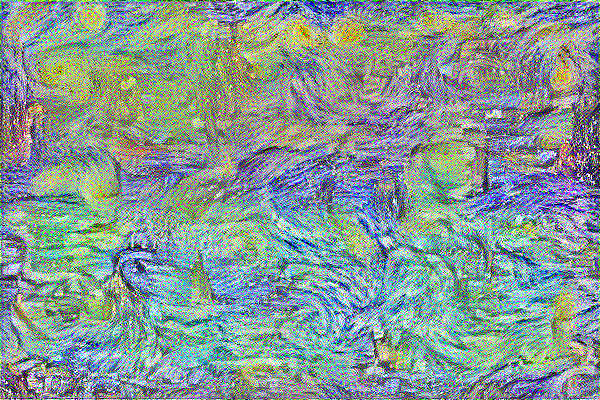

-----------------------
Iteration 2501: loss = 35307096.0 
Iteration 2502: loss = 35296020.0 
Iteration 2503: loss = 35284992.0 
Iteration 2504: loss = 35273944.0 
Iteration 2505: loss = 35262928.0 
Iteration 2506: loss = 35251916.0 
Iteration 2507: loss = 35240900.0 
Iteration 2508: loss = 35229912.0 
Iteration 2509: loss = 35218940.0 
Iteration 2510: loss = 35207972.0 
Iteration 2511: loss = 35197012.0 
Iteration 2512: loss = 35186080.0 
Iteration 2513: loss = 35175120.0 
Iteration 2514: loss = 35164216.0 
Iteration 2515: loss = 35153284.0 
Iteration 2516: loss = 35142392.0 
Iteration 2517: loss = 35131508.0 
Iteration 2518: loss = 35120620.0 
Iteration 2519: loss = 35109760.0 
Iteration 2520: loss = 35098900.0 
Iteration 2521: loss = 35088060.0 
Iteration 2522: loss = 35077228.0 
Iteration 2523: loss = 35066400.0 
Iteration 2524: loss = 35055596.0 
Iteration 2525: loss = 35044796.0 
Iteration 2526: loss = 35033996.0 
Iteration 2527: loss = 35023216.0 
Iteration 2528: loss = 35012476

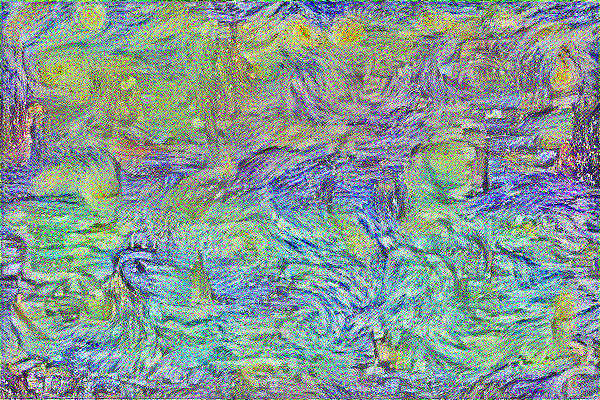

-----------------------
Iteration 2601: loss = 34255584.0 
Iteration 2602: loss = 34245604.0 
Iteration 2603: loss = 34235628.0 
Iteration 2604: loss = 34225660.0 
Iteration 2605: loss = 34215700.0 
Iteration 2606: loss = 34205772.0 
Iteration 2607: loss = 34195820.0 
Iteration 2608: loss = 34185916.0 
Iteration 2609: loss = 34176004.0 
Iteration 2610: loss = 34166064.0 
Iteration 2611: loss = 34156188.0 
Iteration 2612: loss = 34146312.0 
Iteration 2613: loss = 34136432.0 
Iteration 2614: loss = 34126572.0 
Iteration 2615: loss = 34116692.0 
Iteration 2616: loss = 34106828.0 
Iteration 2617: loss = 34097000.0 
Iteration 2618: loss = 34087164.0 
Iteration 2619: loss = 34077352.0 
Iteration 2620: loss = 34067540.0 
Iteration 2621: loss = 34057732.0 
Iteration 2622: loss = 34047948.0 
Iteration 2623: loss = 34038152.0 
Iteration 2624: loss = 34028364.0 
Iteration 2625: loss = 34018604.0 
Iteration 2626: loss = 34008864.0 
Iteration 2627: loss = 33999132.0 
Iteration 2628: loss = 33989384

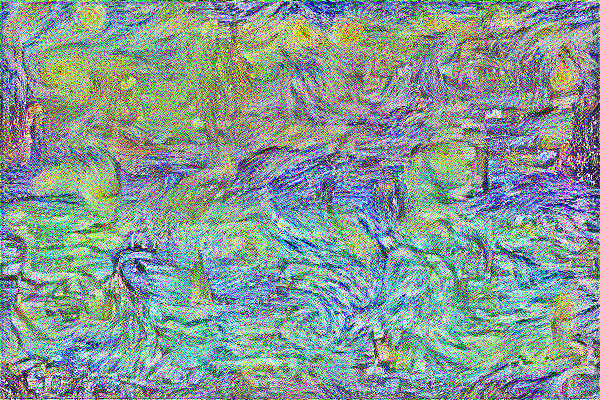

-----------------------
Iteration 2701: loss = 33303502.0 
Iteration 2702: loss = 33294426.0 
Iteration 2703: loss = 33285368.0 
Iteration 2704: loss = 33276306.0 
Iteration 2705: loss = 33267272.0 
Iteration 2706: loss = 33258218.0 
Iteration 2707: loss = 33249184.0 
Iteration 2708: loss = 33240170.0 
Iteration 2709: loss = 33231154.0 
Iteration 2710: loss = 33222154.0 
Iteration 2711: loss = 33213144.0 
Iteration 2712: loss = 33204160.0 
Iteration 2713: loss = 33195184.0 
Iteration 2714: loss = 33186210.0 
Iteration 2715: loss = 33177244.0 
Iteration 2716: loss = 33168304.0 
Iteration 2717: loss = 33159362.0 
Iteration 2718: loss = 33150416.0 
Iteration 2719: loss = 33141506.0 
Iteration 2720: loss = 33132556.0 
Iteration 2721: loss = 33123660.0 
Iteration 2722: loss = 33114732.0 
Iteration 2723: loss = 33105844.0 
Iteration 2724: loss = 33096946.0 
Iteration 2725: loss = 33088084.0 
Iteration 2726: loss = 33079202.0 
Iteration 2727: loss = 33070326.0 
Iteration 2728: loss = 33061480

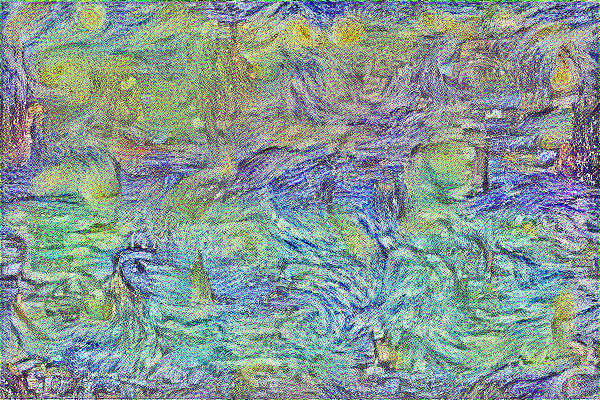

-----------------------
Iteration 2801: loss = 32435826.0 
Iteration 2802: loss = 32427546.0 
Iteration 2803: loss = 32419266.0 
Iteration 2804: loss = 32410980.0 
Iteration 2805: loss = 32402706.0 
Iteration 2806: loss = 32394448.0 
Iteration 2807: loss = 32386178.0 
Iteration 2808: loss = 32377932.0 
Iteration 2809: loss = 32369686.0 
Iteration 2810: loss = 32361440.0 
Iteration 2811: loss = 32353218.0 
Iteration 2812: loss = 32344996.0 
Iteration 2813: loss = 32336780.0 
Iteration 2814: loss = 32328558.0 
Iteration 2815: loss = 32320368.0 
Iteration 2816: loss = 32312178.0 
Iteration 2817: loss = 32303976.0 
Iteration 2818: loss = 32295808.0 
Iteration 2819: loss = 32287634.0 
Iteration 2820: loss = 32279452.0 
Iteration 2821: loss = 32271294.0 
Iteration 2822: loss = 32263148.0 
Iteration 2823: loss = 32254996.0 
Iteration 2824: loss = 32246860.0 
Iteration 2825: loss = 32238736.0 
Iteration 2826: loss = 32230598.0 
Iteration 2827: loss = 32222484.0 
Iteration 2828: loss = 32214388

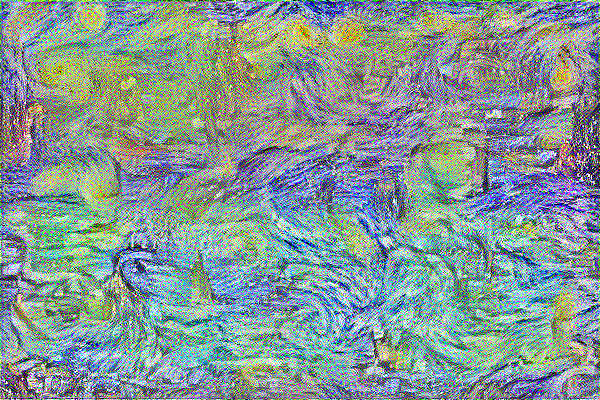

-----------------------
Iteration 2901: loss = 31641092.0 
Iteration 2902: loss = 31633502.0 
Iteration 2903: loss = 31625912.0 
Iteration 2904: loss = 31618326.0 
Iteration 2905: loss = 31610748.0 
Iteration 2906: loss = 31603160.0 
Iteration 2907: loss = 31595596.0 
Iteration 2908: loss = 31588028.0 
Iteration 2909: loss = 31580484.0 
Iteration 2910: loss = 31572936.0 
Iteration 2911: loss = 31565398.0 
Iteration 2912: loss = 31557844.0 
Iteration 2913: loss = 31550322.0 
Iteration 2914: loss = 31542808.0 
Iteration 2915: loss = 31535294.0 
Iteration 2916: loss = 31527774.0 
Iteration 2917: loss = 31520272.0 
Iteration 2918: loss = 31512786.0 
Iteration 2919: loss = 31505284.0 
Iteration 2920: loss = 31497812.0 
Iteration 2921: loss = 31490336.0 
Iteration 2922: loss = 31482862.0 
Iteration 2923: loss = 31475398.0 
Iteration 2924: loss = 31467940.0 
Iteration 2925: loss = 31460494.0 
Iteration 2926: loss = 31453074.0 
Iteration 2927: loss = 31445616.0 
Iteration 2928: loss = 31438192

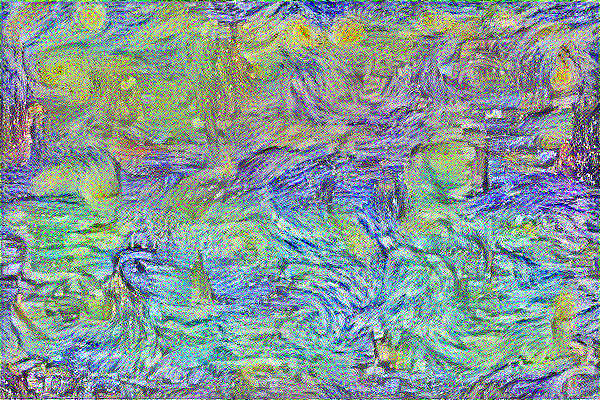

-----------------------
Iteration 3001: loss = 30912356.0 
Iteration 3002: loss = 30905368.0 
Iteration 3003: loss = 30898398.0 
Iteration 3004: loss = 30891400.0 
Iteration 3005: loss = 30884442.0 
Iteration 3006: loss = 30877466.0 
Iteration 3007: loss = 30870514.0 
Iteration 3008: loss = 30863556.0 
Iteration 3009: loss = 30856606.0 
Iteration 3010: loss = 30849658.0 
Iteration 3011: loss = 30842734.0 
Iteration 3012: loss = 30835790.0 
Iteration 3013: loss = 30828878.0 
Iteration 3014: loss = 30821946.0 
Iteration 3015: loss = 30815050.0 
Iteration 3016: loss = 30808134.0 
Iteration 3017: loss = 30801238.0 
Iteration 3018: loss = 30794324.0 
Iteration 3019: loss = 30787464.0 
Iteration 3020: loss = 30780578.0 
Iteration 3021: loss = 30773678.0 
Iteration 3022: loss = 30766808.0 
Iteration 3023: loss = 30759942.0 
Iteration 3024: loss = 30753092.0 
Iteration 3025: loss = 30746236.0 
Iteration 3026: loss = 30739400.0 
Iteration 3027: loss = 30732548.0 
Iteration 3028: loss = 30725700

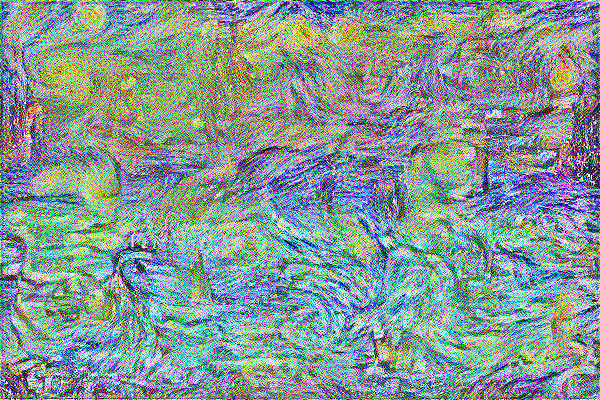

-----------------------
Iteration 3101: loss = 30241068.0 
Iteration 3102: loss = 30234620.0 
Iteration 3103: loss = 30228194.0 
Iteration 3104: loss = 30221758.0 
Iteration 3105: loss = 30215332.0 
Iteration 3106: loss = 30208912.0 
Iteration 3107: loss = 30202492.0 
Iteration 3108: loss = 30196086.0 
Iteration 3109: loss = 30189674.0 
Iteration 3110: loss = 30183282.0 
Iteration 3111: loss = 30176898.0 
Iteration 3112: loss = 30170492.0 
Iteration 3113: loss = 30164118.0 
Iteration 3114: loss = 30157738.0 
Iteration 3115: loss = 30151356.0 
Iteration 3116: loss = 30144998.0 
Iteration 3117: loss = 30138626.0 
Iteration 3118: loss = 30132268.0 
Iteration 3119: loss = 30125928.0 
Iteration 3120: loss = 30119570.0 
Iteration 3121: loss = 30113212.0 
Iteration 3122: loss = 30106878.0 
Iteration 3123: loss = 30100562.0 
Iteration 3124: loss = 30094238.0 
Iteration 3125: loss = 30087906.0 
Iteration 3126: loss = 30081584.0 
Iteration 3127: loss = 30075274.0 
Iteration 3128: loss = 30068976

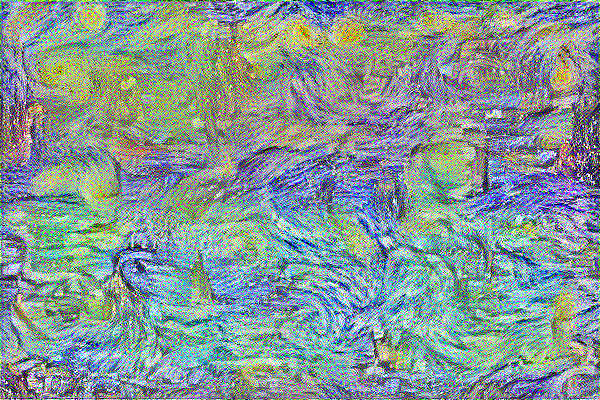

-----------------------
Iteration 3201: loss = 29622178.0 
Iteration 3202: loss = 29616226.0 
Iteration 3203: loss = 29610288.0 
Iteration 3204: loss = 29604338.0 
Iteration 3205: loss = 29598410.0 
Iteration 3206: loss = 29592488.0 
Iteration 3207: loss = 29586564.0 
Iteration 3208: loss = 29580654.0 
Iteration 3209: loss = 29574748.0 
Iteration 3210: loss = 29568830.0 
Iteration 3211: loss = 29562938.0 
Iteration 3212: loss = 29557042.0 
Iteration 3213: loss = 29551136.0 
Iteration 3214: loss = 29545244.0 
Iteration 3215: loss = 29539374.0 
Iteration 3216: loss = 29533476.0 
Iteration 3217: loss = 29527596.0 
Iteration 3218: loss = 29521742.0 
Iteration 3219: loss = 29515862.0 
Iteration 3220: loss = 29510000.0 
Iteration 3221: loss = 29504162.0 
Iteration 3222: loss = 29498308.0 
Iteration 3223: loss = 29492444.0 
Iteration 3224: loss = 29486612.0 
Iteration 3225: loss = 29480772.0 
Iteration 3226: loss = 29474940.0 
Iteration 3227: loss = 29469128.0 
Iteration 3228: loss = 29463286

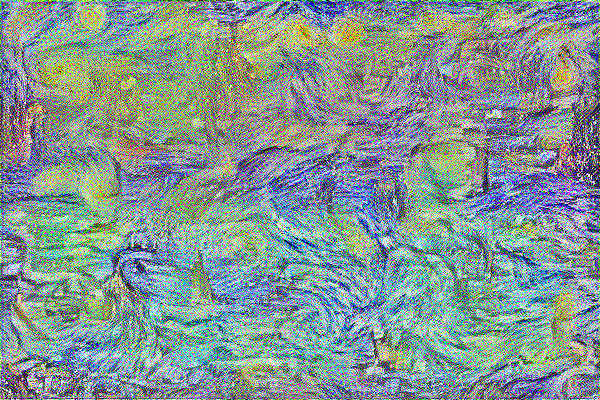

-----------------------
Iteration 3301: loss = 29049348.0 
Iteration 3302: loss = 29043844.0 
Iteration 3303: loss = 29038330.0 
Iteration 3304: loss = 29032810.0 
Iteration 3305: loss = 29027324.0 
Iteration 3306: loss = 29021838.0 
Iteration 3307: loss = 29016330.0 
Iteration 3308: loss = 29010822.0 
Iteration 3309: loss = 29005344.0 
Iteration 3310: loss = 28999850.0 
Iteration 3311: loss = 28994380.0 
Iteration 3312: loss = 28988914.0 
Iteration 3313: loss = 28983442.0 
Iteration 3314: loss = 28977966.0 
Iteration 3315: loss = 28972498.0 
Iteration 3316: loss = 28967050.0 
Iteration 3317: loss = 28961598.0 
Iteration 3318: loss = 28956148.0 
Iteration 3319: loss = 28950722.0 
Iteration 3320: loss = 28945268.0 
Iteration 3321: loss = 28939836.0 
Iteration 3322: loss = 28934406.0 
Iteration 3323: loss = 28928992.0 
Iteration 3324: loss = 28923572.0 
Iteration 3325: loss = 28918142.0 
Iteration 3326: loss = 28912726.0 
Iteration 3327: loss = 28907316.0 
Iteration 3328: loss = 28901926

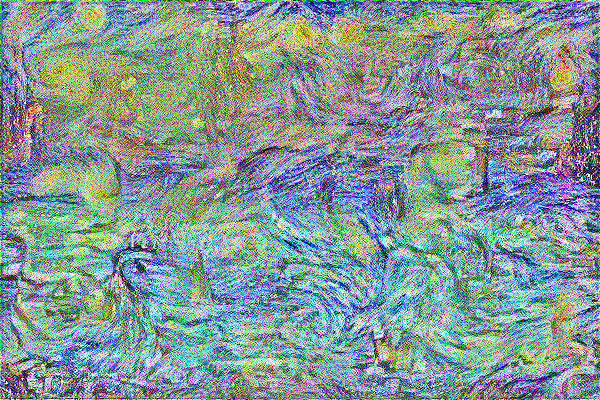

-----------------------
Iteration 3401: loss = 28518192.0 
Iteration 3402: loss = 28513074.0 
Iteration 3403: loss = 28507966.0 
Iteration 3404: loss = 28502866.0 
Iteration 3405: loss = 28497770.0 
Iteration 3406: loss = 28492658.0 
Iteration 3407: loss = 28487586.0 
Iteration 3408: loss = 28482474.0 
Iteration 3409: loss = 28477388.0 
Iteration 3410: loss = 28472308.0 
Iteration 3411: loss = 28467224.0 
Iteration 3412: loss = 28462142.0 
Iteration 3413: loss = 28457072.0 
Iteration 3414: loss = 28452002.0 
Iteration 3415: loss = 28446924.0 
Iteration 3416: loss = 28441872.0 
Iteration 3417: loss = 28436820.0 
Iteration 3418: loss = 28431770.0 
Iteration 3419: loss = 28426726.0 
Iteration 3420: loss = 28421664.0 
Iteration 3421: loss = 28416628.0 
Iteration 3422: loss = 28411584.0 
Iteration 3423: loss = 28406542.0 
Iteration 3424: loss = 28401510.0 
Iteration 3425: loss = 28396490.0 
Iteration 3426: loss = 28391442.0 
Iteration 3427: loss = 28386446.0 
Iteration 3428: loss = 28381420

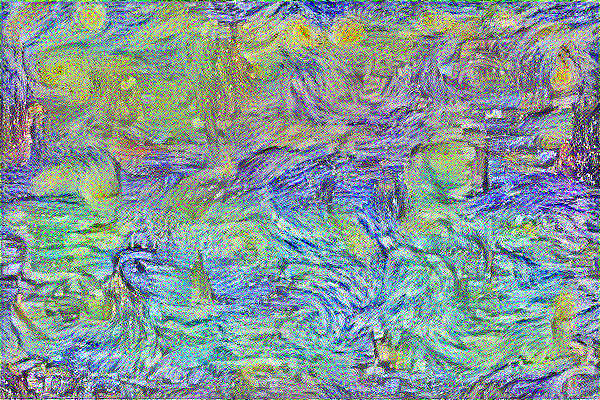

-----------------------
Iteration 3501: loss = 28024998.0 
Iteration 3502: loss = 28020232.0 
Iteration 3503: loss = 28015502.0 
Iteration 3504: loss = 28010760.0 
Iteration 3505: loss = 28006008.0 
Iteration 3506: loss = 28001260.0 
Iteration 3507: loss = 27996524.0 
Iteration 3508: loss = 27991794.0 
Iteration 3509: loss = 27987056.0 
Iteration 3510: loss = 27982348.0 
Iteration 3511: loss = 27977622.0 
Iteration 3512: loss = 27972890.0 
Iteration 3513: loss = 27968158.0 
Iteration 3514: loss = 27963450.0 
Iteration 3515: loss = 27958770.0 
Iteration 3516: loss = 27954042.0 
Iteration 3517: loss = 27949346.0 
Iteration 3518: loss = 27944640.0 
Iteration 3519: loss = 27939950.0 
Iteration 3520: loss = 27935246.0 
Iteration 3521: loss = 27930554.0 
Iteration 3522: loss = 27925860.0 
Iteration 3523: loss = 27921190.0 
Iteration 3524: loss = 27916494.0 
Iteration 3525: loss = 27911824.0 
Iteration 3526: loss = 27907140.0 
Iteration 3527: loss = 27902500.0 
Iteration 3528: loss = 27897800

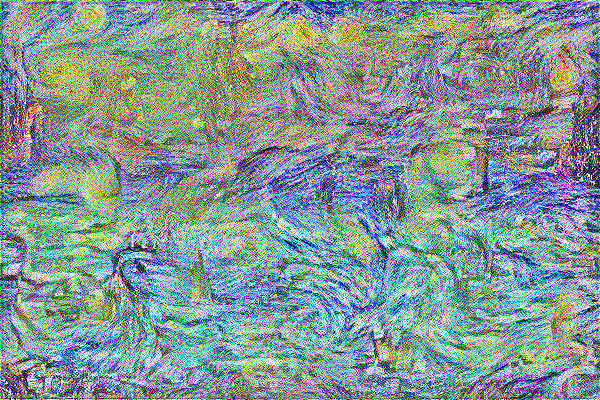

-----------------------
Iteration 3601: loss = 27565754.0 
Iteration 3602: loss = 27561314.0 
Iteration 3603: loss = 27556896.0 
Iteration 3604: loss = 27552456.0 
Iteration 3605: loss = 27548036.0 
Iteration 3606: loss = 27543628.0 
Iteration 3607: loss = 27539200.0 
Iteration 3608: loss = 27534776.0 
Iteration 3609: loss = 27530366.0 
Iteration 3610: loss = 27525950.0 
Iteration 3611: loss = 27521542.0 
Iteration 3612: loss = 27517154.0 
Iteration 3613: loss = 27512736.0 
Iteration 3614: loss = 27508348.0 
Iteration 3615: loss = 27503952.0 
Iteration 3616: loss = 27499568.0 
Iteration 3617: loss = 27495172.0 
Iteration 3618: loss = 27490804.0 
Iteration 3619: loss = 27486412.0 
Iteration 3620: loss = 27482032.0 
Iteration 3621: loss = 27477654.0 
Iteration 3622: loss = 27473282.0 
Iteration 3623: loss = 27468902.0 
Iteration 3624: loss = 27464534.0 
Iteration 3625: loss = 27460170.0 
Iteration 3626: loss = 27455802.0 
Iteration 3627: loss = 27451442.0 
Iteration 3628: loss = 27447090

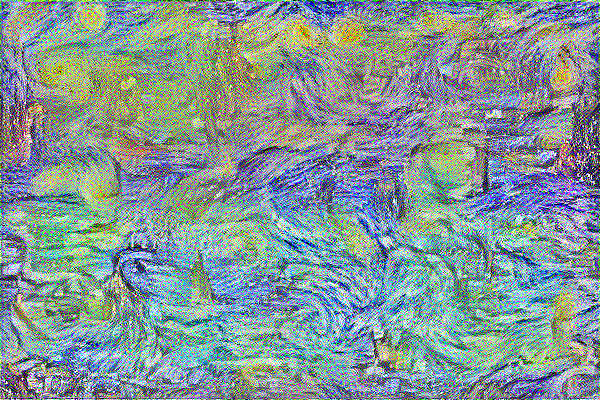

-----------------------
Iteration 3701: loss = 27136956.0 
Iteration 3702: loss = 27132828.0 
Iteration 3703: loss = 27128658.0 
Iteration 3704: loss = 27124542.0 
Iteration 3705: loss = 27120386.0 
Iteration 3706: loss = 27116250.0 
Iteration 3707: loss = 27112126.0 
Iteration 3708: loss = 27107992.0 
Iteration 3709: loss = 27103860.0 
Iteration 3710: loss = 27099740.0 
Iteration 3711: loss = 27095614.0 
Iteration 3712: loss = 27091496.0 
Iteration 3713: loss = 27087372.0 
Iteration 3714: loss = 27083260.0 
Iteration 3715: loss = 27079148.0 
Iteration 3716: loss = 27075036.0 
Iteration 3717: loss = 27070936.0 
Iteration 3718: loss = 27066826.0 
Iteration 3719: loss = 27062722.0 
Iteration 3720: loss = 27058620.0 
Iteration 3721: loss = 27054536.0 
Iteration 3722: loss = 27050432.0 
Iteration 3723: loss = 27046348.0 
Iteration 3724: loss = 27042240.0 
Iteration 3725: loss = 27038162.0 
Iteration 3726: loss = 27034074.0 
Iteration 3727: loss = 27030002.0 
Iteration 3728: loss = 27025928

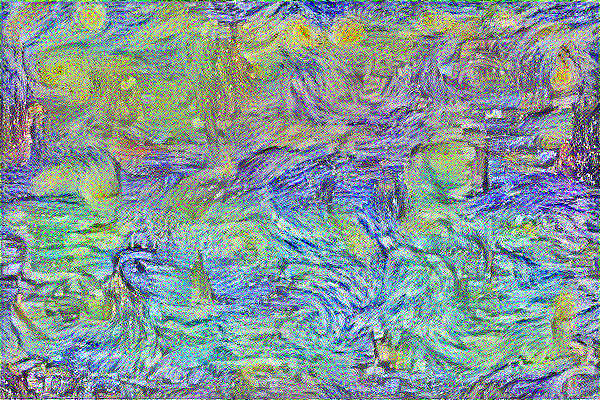

-----------------------
Iteration 3801: loss = 26735094.0 
Iteration 3802: loss = 26731192.0 
Iteration 3803: loss = 26727300.0 
Iteration 3804: loss = 26723402.0 
Iteration 3805: loss = 26719522.0 
Iteration 3806: loss = 26715640.0 
Iteration 3807: loss = 26711772.0 
Iteration 3808: loss = 26707890.0 
Iteration 3809: loss = 26704018.0 
Iteration 3810: loss = 26700160.0 
Iteration 3811: loss = 26696288.0 
Iteration 3812: loss = 26692412.0 
Iteration 3813: loss = 26688556.0 
Iteration 3814: loss = 26684684.0 
Iteration 3815: loss = 26680842.0 
Iteration 3816: loss = 26676976.0 
Iteration 3817: loss = 26673136.0 
Iteration 3818: loss = 26669274.0 
Iteration 3819: loss = 26665432.0 
Iteration 3820: loss = 26661582.0 
Iteration 3821: loss = 26657740.0 
Iteration 3822: loss = 26653888.0 
Iteration 3823: loss = 26650042.0 
Iteration 3824: loss = 26646210.0 
Iteration 3825: loss = 26642390.0 
Iteration 3826: loss = 26638552.0 
Iteration 3827: loss = 26634704.0 
Iteration 3828: loss = 26630894

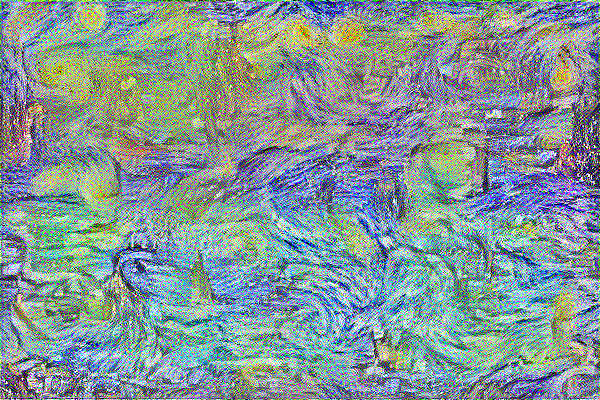

-----------------------
Iteration 3901: loss = 26358092.0 
Iteration 3902: loss = 26354440.0 
Iteration 3903: loss = 26350780.0 
Iteration 3904: loss = 26347132.0 
Iteration 3905: loss = 26343496.0 
Iteration 3906: loss = 26339870.0 
Iteration 3907: loss = 26336218.0 
Iteration 3908: loss = 26332586.0 
Iteration 3909: loss = 26328946.0 
Iteration 3910: loss = 26325308.0 
Iteration 3911: loss = 26321684.0 
Iteration 3912: loss = 26318072.0 
Iteration 3913: loss = 26314428.0 
Iteration 3914: loss = 26310818.0 
Iteration 3915: loss = 26307202.0 
Iteration 3916: loss = 26303592.0 
Iteration 3917: loss = 26299968.0 
Iteration 3918: loss = 26296360.0 
Iteration 3919: loss = 26292736.0 
Iteration 3920: loss = 26289144.0 
Iteration 3921: loss = 26285530.0 
Iteration 3922: loss = 26281938.0 
Iteration 3923: loss = 26278346.0 
Iteration 3924: loss = 26274746.0 
Iteration 3925: loss = 26271156.0 
Iteration 3926: loss = 26267566.0 
Iteration 3927: loss = 26263970.0 
Iteration 3928: loss = 26260396

UnboundLocalError: local variable 'final_image_arr' referenced before assignment

In [41]:
optimizer = keras.optimizers.Adam(keras.optimizers.schedules.ExponentialDecay(
        initial_learning_rate=100.0, decay_steps=50, decay_rate=0.96
    ))

generated_image = combine(4000, combined_image_pr,content_image_pr,style_image_pr, 1, 1, 1, optimizer)